# Demo versione CUDA

In [1]:
using Test

In [2]:
# Carica il codice per la simulazione
include("src/CUDAmd.jl")

Main.CUDAmd

In [3]:
# Carica il codice per salvataggi su disco, generare dati, creare animazioni
include("src/utilmd.jl")

Main.Utilmd

In [4]:
# Threads per blocco
const TPB = 256

256

In [5]:
# Esegue una simulazione con dati casuali e salva su disco i dati per ripresa.
function random_sim(nsteps, sinterval, dt, dim, part_num, num_part_types, box_size, periodic, restrict)
    # Genera dati casuali
    pos, acc, vel, masses, interactions, ptypes = CUDAmd.random_data(dim, part_num, num_part_types, box_size)
    
    # Simulazione    
    spos = CUDAmd.dynamics_sim!(TPB, nsteps, sinterval, true, dt, pos, vel, acc, masses, 
                                interactions, ptypes, box_size, periodic, restrict)
    
    # Per il salvataggio su disco salvare anche le altre matrici modificate
    file_name = "CUDA_random_$(dim)D_$(part_num)p"
    Utilmd.disk_save(file_name * "_data", spos[end,:,:], vel, acc, masses, interactions, ptypes, box_size, periodic, restrict)
    
    return spos, ptypes, masses, interactions, file_name    
end

random_sim (generic function with 1 method)

### Simulazione 3D

In [6]:
# Parametri animazione
const duration3D = 30; # durata in secondi
const lims3D = (0, 10); # Limiti della visuale
const ticks3D = 0:1:10; # Tacche su ogni asse

In [7]:
# Simulazione 3D ('_d' indica che il dato è sul device scheda grafica )
spos3D_d, ptypes3D_d, masses3D_d, interactions3D_d, file_name3D = random_sim(30*duration3D, 1, 1/30f0, 3, 200, 3, 10.0f0, false, true);

In [8]:
# Verifica consistenza
println("Any NaN?: ", any(isnan, spos3D_d))
println("Any Inf?: ", any(isinf, spos3D_d))

Any NaN?: false
Any Inf?: false


In [9]:
# Sposta da VRAM a RAM (per generare l'animazione)
spos3D, ptypes3D = Array(spos3D_d), Array(ptypes3D_d);

┌ Info: Saved animation to 
│   fn = /home/enrico/Scrivania/GitRepos/molecular-dynamics-cuda/main/CUDA_random_3D_200p.gif
└ @ Plots /home/enrico/.julia/packages/Plots/CFRKM/src/animation.jl:98


Plots.AnimatedGif("/home/enrico/Scrivania/GitRepos/molecular-dynamics-cuda/main/CUDA_random_3D_200p.gif")
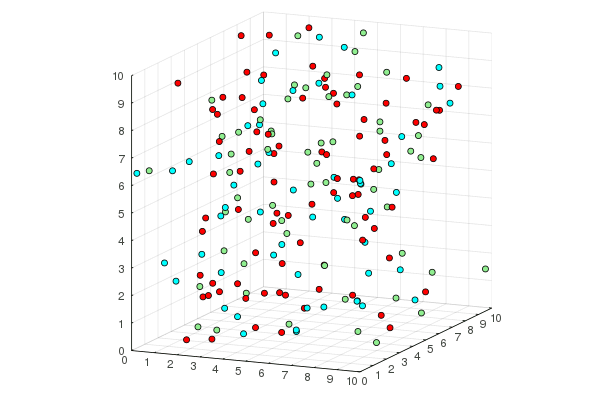

In [10]:
# Genera animazione e salva gif su disco
Utilmd.gif_animate3D(spos3D, ptypes3D, lims3D, ticks3D, file_name3D)

In [11]:
# Visualizza masse
masses3D_d

3-element CuArrays.CuArray{Float32,1,Nothing}:
 2.0
 3.0
 3.0

In [12]:
# Visualizza interazioni
interactions3D_d

3×3 CuArrays.CuArray{Float32,2,Nothing}:
 -0.43655     0.0838135   0.537338 
  0.0838135  -0.966899    0.541425 
  0.537338    0.541425   -0.0161383

In [13]:
# RESUME TEST #
# Continua simulazione da dati salvati
ld = Utilmd.disk_load(file_name3D * "_data")
spos3DResumed_d = CUDAmd.dynamics_sim!(TPB, 30*duration3D, 1, true, 1/30f0, ld.pos, ld.vel, ld.acc, ld.masses, ld.interactions, ld.ptypes, ld.box_size, ld.periodic, ld.restrict);

In [14]:
# Sposta da VRAM a RAM (per generare l'animazione)
spos3DResumed, ptypes3DResumed = Array(spos3DResumed_d), Array(ld.ptypes);

┌ Info: Saved animation to 
│   fn = /home/enrico/Scrivania/GitRepos/molecular-dynamics-cuda/main/CUDA_random_3D_200p_resumed.gif
└ @ Plots /home/enrico/.julia/packages/Plots/CFRKM/src/animation.jl:98


Plots.AnimatedGif("/home/enrico/Scrivania/GitRepos/molecular-dynamics-cuda/main/CUDA_random_3D_200p_resumed.gif")
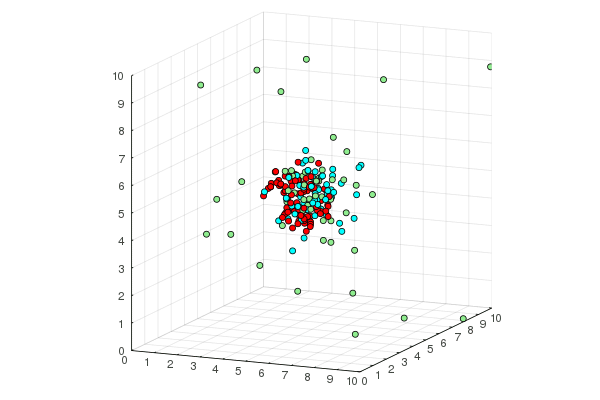

In [15]:
# Genera animazione e salva gif su disco
Utilmd.gif_animate3D(spos3DResumed, ptypes3DResumed, lims3D, ticks3D, file_name3D * "_resumed")

### Simulazione 2D

In [16]:
# Parametri animazione
const duration2D = 30; # durata in secondi
const lims2D = (-10, 20); # Limiti della visuale
const ticks2D = -10:5:20; # Tacche su ogni asse

In [17]:
# Simulazione 2D
spos2D_d, ptypes2D_d, masses2D_d, interactions2D_d, file_name2D = random_sim(30*duration2D, 1, 1/30f0, 2, 300, 2, 10.0f0, true, false);

In [18]:
# Controllo consistenza
println("Any NaN?: ", any(isnan, spos2D_d))
println("Any Inf?: ", any(isinf, spos2D_d))

Any NaN?: false
Any Inf?: false


In [19]:
# Sposta da VRAM a RAM (per generare l'animazione)
spos2D, ptypes2D = Array(spos2D_d), Array(ptypes2D_d);

┌ Info: Saved animation to 
│   fn = /home/enrico/Scrivania/GitRepos/molecular-dynamics-cuda/main/CUDA_random_2D_300p.gif
└ @ Plots /home/enrico/.julia/packages/Plots/CFRKM/src/animation.jl:98


Plots.AnimatedGif("/home/enrico/Scrivania/GitRepos/molecular-dynamics-cuda/main/CUDA_random_2D_300p.gif")
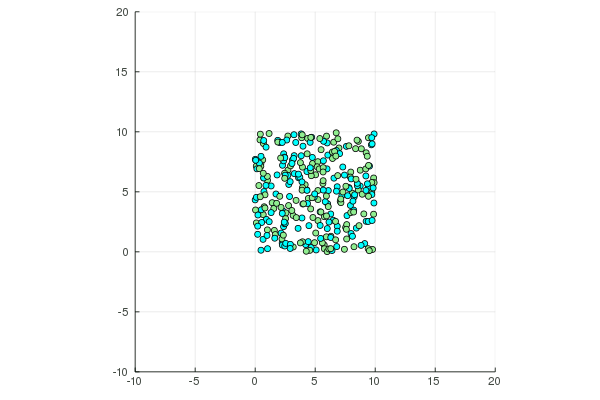

In [20]:
# Genera animazione e salva gif su disco
Utilmd.gif_animate2D(spos2D, ptypes2D, lims2D, ticks2D, file_name2D)

In [21]:
# Visualizza masse
masses2D_d

2-element CuArrays.CuArray{Float32,1,Nothing}:
 1.0
 2.0

In [22]:
# Visualizza interazioni
interactions2D_d

2×2 CuArrays.CuArray{Float32,2,Nothing}:
 -0.797905   0.927906
  0.927906  -0.800437